In [ ]:
# IMPORTANT:
#   Whenever you start a new colab runtime, use the following code to download
#   the training dataset onto the runtime local storage.
#   This should take ~3-5 mins for the whole dataset.
#   You can then load data from the local storage (/content/data) into your colab
#   notebook using the `h5py` library (see example below).
from huggingface_hub import hf_hub_download
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="train.h5", repo_type="dataset", local_dir="data")
hf_hub_download(repo_id="benmoseley/ese-dl-2024-25-group-project", filename="events.csv", repo_type="dataset", local_dir="data")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


train.h5:   0%|          | 0.00/10.7G [00:00<?, ?B/s]

events.csv:   0%|          | 0.00/782k [00:00<?, ?B/s]

'data/events.csv'

In [ ]:
# this DataFrame contains all of the event meta data
df = pd.read_csv("data/events.csv", parse_dates=["start_utc"])
df

,id,img_type,start_utc,llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon,proj,height_m,width_m
0,S778114,ir069,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
1,S778114,ir107,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
2,S778114,lght,NaT,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3,S778114,vil,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
4,S778114,vis,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.944590,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
...,...,...,...,...,...,...,...,...,...,...
3995,S832818,ir069,2019-07-28 17:44:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3996,S832818,ir107,2019-07-28 17:44:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3997,S832818,lght,NaT,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3998,S832818,vil,2019-07-28 17:45:00+00:00,46.493514,-100.371384,49.953392,-95.191216,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0


In [ ]:
# this function loads all of the image arrays for a given id
def load_event(id):
    "Load event"
    with h5py.File(f'data/train.h5','r') as f:
        event = {img_type: f[id][img_type][:] for img_type in ['vis', 'ir069', 'ir107', 'vil', 'lght']}
    return event

event = load_event("S778114")
for img_type in event:
    print(f"{img_type}: {event[img_type].shape} ({event[img_type].dtype})")

vis: (384, 384, 36) (int16)
ir069: (192, 192, 36) (int16)
ir107: (192, 192, 36) (int16)
vil: (384, 384, 36) (uint8)
lght: (38777, 5) (float32)


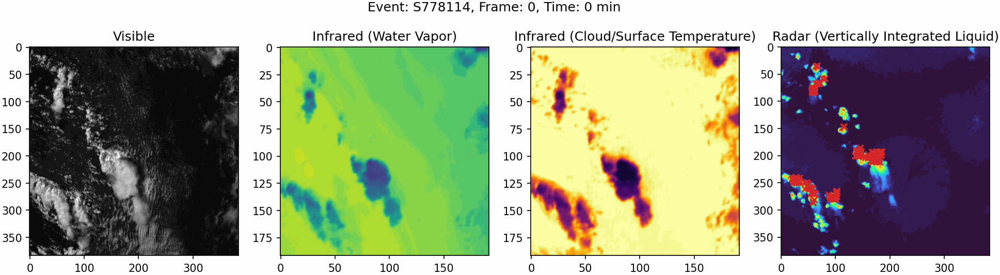

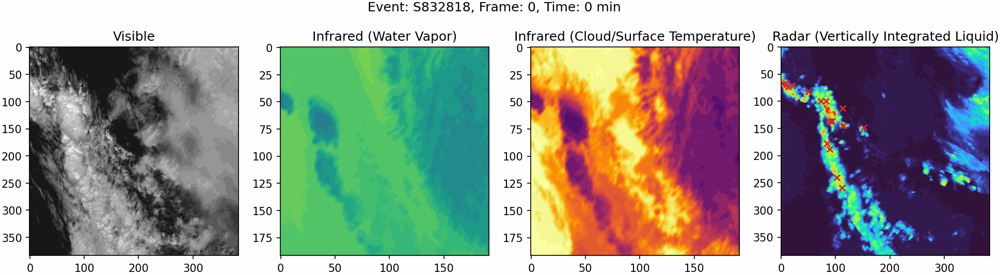

In [ ]:
# these functions will plot an event

def make_gif(outfile, files, fps=10, loop=0):
    "Helper function for saving GIFs"
    imgs = [PIL.Image.open(file) for file in files]
    imgs[0].save(fp=outfile, format='gif', append_images=imgs[1:],
                 save_all=True, duration=int(1000/fps), loop=loop)
    im = IPython.display.Image(filename=outfile)
    im.reload()
    return im

def plot_event(id, output_gif=False, save_gif=False):
    "Helper function for plotting an event"
    event = load_event(id)
    t = event["lght"][:,0]# time of lightning strike (in seconds relative to first frame)
    def plot_frame(ti):
        f = (t >= ti*5*60 - 2.5*60) & (t < ti*5*60 + 2.5*60)# find which lightning strikes fall in current frame
        fig,axs = plt.subplots(1,4,figsize=(16,4))
        fig.suptitle(f"Event: {id}, Frame: {ti}, Time: {ti*5} min")
        axs[0].imshow(event["vis"][:,:,ti], vmin=0, vmax=10000, cmap="grey"), axs[0].set_title('Visible')
        axs[1].imshow(event["ir069"][:,:,ti], vmin=-8000, vmax=-1000, cmap="viridis"), axs[1].set_title('Infrared (Water Vapor)')
        axs[2].imshow(event["ir107"][:,:,ti], vmin=-7000, vmax=2000, cmap="inferno"), axs[2].set_title('Infrared (Cloud/Surface Temperature)')
        axs[3].imshow(event["vil"][:,:,ti], vmin=0, vmax=255, cmap="turbo"), axs[3].set_title('Radar (Vertically Integrated Liquid)')
        axs[3].scatter(event["lght"][f,3], event["lght"][f,4], marker="x", s=30, c="tab:red")
        axs[3].set_xlim(0,384), axs[3].set_ylim(384,0)
        if output_gif:
            file = f"_temp_{id}_{ti}.png"
            fig.savefig(file, bbox_inches="tight", dpi=150, pad_inches=0.02, facecolor="white")
            plt.close()
        else:
            plt.show()
    if output_gif:
        for ti in range(36): plot_frame(ti)
        im = make_gif(f"{id}.gif", [f"_temp_{id}_{ti}.png" for ti in range(36)])
        for ti in range(36): os.remove(f"_temp_{id}_{ti}.png")
        IPython.display.display(im)
        if not save_gif: os.remove(f"{id}.gif")
    else:
        plot_frame(0)
        plot_frame(17)
        plot_frame(34)

plot_event("S778114", output_gif=True, save_gif=True)
plot_event("S832818", output_gif=True, save_gif=True)

# **Import required library**

In [ ]:
from skimage.transform import resize
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
import h5py
import pandas as pd
import random
from scipy.ndimage import zoom
import torch.nn as nn
import torch.optim as optim
import IPython
import PIL
import os
import io

# Import function from Utils
from utils.vil_imputation import *
from utils.preprocessing import *


## **Parameter Settings**

In [ ]:
# Global max/min values for min-max normalization
global_vis_max = 12896
global_ir069_max, global_ir069_min = -792, -8472
global_ir107_max, global_ir107_min = 5313, -8467

# Number of events to use for training or analysis
num = 600

## **Funciont of getting event ids**

In [ ]:
event_ids, test_ids= get_event_ids(num)

print(len(event_ids))
print(len(test_ids))
print(event_ids)
print(test_ids)

480
120
['S824192', 'S837635', 'S837651', 'S806824', 'S846450', 'S786552', 'S783688', 'S846651', 'S782481', 'S827260', 'S779911', 'S824296', 'S820684', 'S821244', 'S848127', 'S824886', 'S786200', 'S845424', 'S784856', 'S818174', 'S779396', 'S810157', 'S805122', 'S802418', 'S835728', 'S809420', 'S786907', 'S771210', 'S841285', 'S817231', 'S800493', 'S801234', 'S798711', 'S814025', 'S837644', 'S840342', 'S822946', 'S830928', 'S787165', 'S795988', 'S786608', 'S780823', 'S809699', 'S812905', 'S845987', 'S826589', 'S782058', 'S798658', 'S814296', 'S819465', 'S813145', 'S797541', 'S821850', 'S775287', 'S817689', 'S793714', 'S816423', 'S798681', 'S810149', 'S777831', 'S784255', 'S820947', 'S826000', 'S793266', 'S841387', 'S834579', 'S815893', 'S821901', 'S818322', 'S771097', 'S841443', 'S843101', 'S785742', 'S790513', 'S773752', 'S775278', 'S843228', 'S796999', 'S799001', 'S774586', 'S835952', 'S807044', 'S829342', 'S790227', 'S839767', 'S827374', 'S810852', 'S822183', 'S786425', 'S789824', '

# **Data Preprocessing**


In [ ]:
X, Y = load_event_subset(event_ids)
X_test, Y_test = load_event_subset(test_ids)

print("Subset Input Shape:", X.shape)
print("Subset Output Shape:", Y.shape)

print("Test Input Shape:", X_test.shape)
print("Test Output Shape:", Y_test.shape)

Subset Input Shape: (3840, 384, 384, 3)
Subset Output Shape: (3840, 384, 384)
Test Input Shape: (960, 384, 384, 3)
Test Output Shape: (960, 384, 384)


In [ ]:
from sklearn.model_selection import train_test_split

# Split the data: 80% train data set and 20% validation data set.
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.2, random_state=42)

print("Training set:", X_train.shape, Y_train.shape)
print("Validation set:", X_val.shape, Y_val.shape)

In [ ]:
# Create train and validation loaders
train_loader, val_loader = create_dataloaders(X_train, Y_train, X_val, Y_val)

# **Bonus Tasks**

# **1.Scaling laws**

### **i. Effect of epoch change on training and validation loss (U-Net vs. CNN)**

Compare the training loss and validation loss of the two models for 10, 30 and 50 epochs.

50 epochs of the trained models have been saved in task2, just train 10 and 30 epochs and load the saved 50 epochs to visualise the results.

In [ ]:
# Deine U-Net Model
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # --- Encoder layers (downsampling) ---
        self.encoder1 = self.conv_block(3, 64)
        self.encoder2 = self.conv_block(64, 128)
        self.encoder3 = self.conv_block(128, 256)
        self.encoder4 = self.conv_block(256, 512)

        # Pooling reduces spatial dimensions
        self.pool = nn.MaxPool2d(2)

        # Bottleneck acts as the deepest layer
        self.bottleneck = self.conv_block(512, 1024)

        # --- Decoder layers (upsampling) ---
        # Each upconv doubles resolution, then skip-connection merges with encoder output
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = self.conv_block(1024, 512)
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = self.conv_block(512, 256)
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = self.conv_block(256, 128)
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = self.conv_block(128, 64)

        # Final 1×1 conv for single-channel output
        self.final = nn.Conv2d(64, 1, kernel_size=1)
        # Sigmoid activation to map output to [0,1]，which can transform to 0 - 255 by multiplicating 255.
        self.sigmoid = nn.Sigmoid()

    def conv_block(self, in_channels, out_channels):
        """
        A helper function creating two (Conv + BN + ReLU) layers.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # --- Encoding path ---
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool(enc1))
        enc3 = self.encoder3(self.pool(enc2))
        enc4 = self.encoder4(self.pool(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool(enc4))

        # --- Decoding path with skip connections ---
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)

        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)

        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)

        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)

        # Final 1-channel output with sigmoid
        return self.sigmoid(self.final(dec1))

# Instantiate the model
model = UNet()
# Define a straightforward encoder-decoder CNN
class EnhancedCNNModel(nn.Module):
    def __init__(self):
        super(EnhancedCNNModel, self).__init__()
        # --- Encoder (downsampling) ---
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )

        # --- Decoder (upsampling) ---
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.ConvTranspose2d(64, 1, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Encode (downsample)
        x = self.encoder(x)

        # Decode (upsample)
        x = self.decoder(x)
        return x

# Instantiate the baseline CNN model
model = EnhancedCNNModel()



In [ ]:

# Check if there is a GPU available, if not then use the CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def evaluate_saved_model(model_class, saved_model_path, train_loader, val_loader, device, criterion):
    model = model_class().to(device)
    model.load_state_dict(torch.load(saved_model_path))
    model.eval()

    train_loss, val_loss = 0, 0
    with torch.no_grad():
        for X_batch, Y_batch in train_loader:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
            outputs = model(X_batch)
            train_loss += criterion(outputs, Y_batch).item()
        train_loss /= len(train_loader)

        for X_batch, Y_batch in val_loader:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
            outputs = model(X_batch)
            val_loss += criterion(outputs, Y_batch).item()
        val_loss /= len(val_loader)

    return train_loss, val_loss

# Define the training process
def train_model(model_class, num_epochs, train_loader, val_loader, device):
    model = model_class().to(device)
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=1e-4)
    criterion = nn.MSELoss()
    train_losses, val_losses = [], []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for X_batch, Y_batch in train_loader:
            X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, Y_batch)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        train_loss /= len(train_loader)
        train_losses.append(train_loss)

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for X_batch, Y_batch in val_loader:
                X_batch, Y_batch = X_batch.to(device), Y_batch.to(device)
                outputs = model(X_batch)
                val_loss += criterion(outputs, Y_batch).item()
        val_loss /= len(val_loader)
        val_losses.append(val_loss)

        print(f"Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")

    return train_losses, val_losses

# Training and assessment logic
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
epoch_list = [10, 30, 50]
train_losses_epochs_unet, val_losses_epochs_unet = [], []
train_losses_epochs_cnn, val_losses_epochs_cnn = [], []

for num_epochs in epoch_list[:-1]: #Train only 10 and 30 epochs
    print(f"\nTraining U-Net for {num_epochs} epochs...")
    train_loss, val_loss = train_model(UNet, num_epochs, train_loader, val_loader, device)
    train_losses_epochs_unet.append(train_loss[-1])
    val_losses_epochs_unet.append(val_loss[-1])

    print(f"\nTraining CNN for {num_epochs} epochs...")
    train_loss, val_loss = train_model(EnhancedCNNModel, num_epochs, train_loader, val_loader, device)
    train_losses_epochs_cnn.append(train_loss[-1])
    val_losses_epochs_cnn.append(val_loss[-1])

# Load 50-epoch model
unet_path = "/content/drive/MyDrive/unet_model.pth"
cnn_path = "/content/drive/MyDrive/cnn_model.pth"

train_50_unet, val_50_unet = evaluate_saved_model(UNet, unet_path, train_loader, val_loader, device, nn.MSELoss())
train_50_cnn, val_50_cnn = evaluate_saved_model(EnhancedCNNModel, cnn_path, train_loader, val_loader, device, nn.MSELoss())

train_losses_epochs_unet.append(train_50_unet)
val_losses_epochs_unet.append(val_50_unet)
train_losses_epochs_cnn.append(train_50_cnn)
val_losses_epochs_cnn.append(val_50_cnn)

# Print results
print("\nResults for U-Net:")
for i, epochs in enumerate(epoch_list):
    print(f"Epochs: {epochs}, Train Loss: {train_losses_epochs_unet[i]:.4f}, Validation Loss: {val_losses_epochs_unet[i]:.4f}")

print("\nResults for CNN:")
for i, epochs in enumerate(epoch_list):
    print(f"Epochs: {epochs}, Train Loss: {train_losses_epochs_cnn[i]:.4f}, Validation Loss: {val_losses_epochs_cnn[i]:.4f}")





Training U-Net for 10 epochs...
Epoch 1/10, Train Loss: 0.0602, Validation Loss: 0.0371
Epoch 2/10, Train Loss: 0.0323, Validation Loss: 0.1400
Epoch 3/10, Train Loss: 0.0241, Validation Loss: 0.0223
Epoch 4/10, Train Loss: 0.0209, Validation Loss: 0.0211
Epoch 5/10, Train Loss: 0.0182, Validation Loss: 0.0183
Epoch 6/10, Train Loss: 0.0168, Validation Loss: 0.0164
Epoch 7/10, Train Loss: 0.0162, Validation Loss: 0.0154
Epoch 8/10, Train Loss: 0.0170, Validation Loss: 0.0172
Epoch 9/10, Train Loss: 0.0152, Validation Loss: 0.0145
Epoch 10/10, Train Loss: 0.0145, Validation Loss: 0.0138

Training CNN for 10 epochs...
Epoch 1/10, Train Loss: 0.0474, Validation Loss: 0.0238
Epoch 2/10, Train Loss: 0.0212, Validation Loss: 0.0190
Epoch 3/10, Train Loss: 0.0179, Validation Loss: 0.0176
Epoch 4/10, Train Loss: 0.0166, Validation Loss: 0.0157
Epoch 5/10, Train Loss: 0.0159, Validation Loss: 0.0159
Epoch 6/10, Train Loss: 0.0155, Validation Loss: 0.0162
Epoch 7/10, Train Loss: 0.0151, Validat

<ipython-input-26-f1e22827061c>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(saved_model_path))



Results for U-Net:
Epochs: 10, Train Loss: 0.0145, Validation Loss: 0.0138
Epochs: 30, Train Loss: 0.0111, Validation Loss: 0.0120
Epochs: 50, Train Loss: 0.0084, Validation Loss: 0.0085

Results for CNN:
Epochs: 10, Train Loss: 0.0147, Validation Loss: 0.0168
Epochs: 30, Train Loss: 0.0133, Validation Loss: 0.0133
Epochs: 50, Train Loss: 0.0124, Validation Loss: 0.0127


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


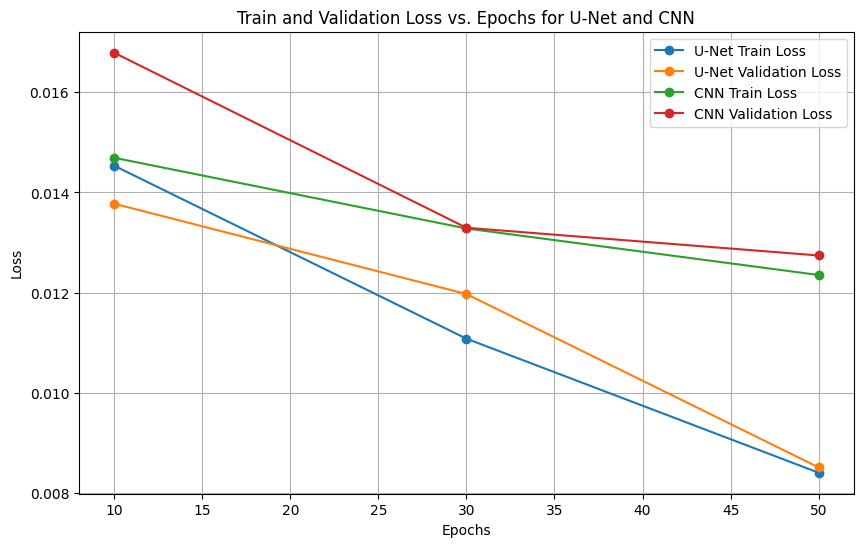

In [ ]:
# Visualisation of U-Net and CNN losses at different epochs
plt.figure(figsize=(10, 6))
plt.plot(epoch_list, train_losses_epochs_unet, marker='o', label="U-Net Train Loss")
plt.plot(epoch_list, val_losses_epochs_unet, marker='o', label="U-Net Validation Loss")
plt.plot(epoch_list, train_losses_epochs_cnn, marker='o', label="CNN Train Loss")
plt.plot(epoch_list, val_losses_epochs_cnn, marker='o', label="CNN Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Train and Validation Loss vs. Epochs for U-Net and CNN")
plt.legend()
plt.grid(True)
plt.show()

### **Analysis:**

**------Training and validation loss of U-Net:**

Both training loss and validation loss decrease significantly with increasing training rounds, especially from 10 to 30 epochs. From 30 to 50 epochs, the decreasing trend slows down, indicating that the model is gradually approaching convergence. The gap between the validation loss and the training loss is very small, indicating that the U-Net model has a better generalisation ability and there is no obvious overfitting.

**------Training and validation loss of CNN:**

The training and validation loss of CNN also decreases gradually with the increase of epoch, but the decrease is overall smaller than that of U-Net. The decrease in training loss from 30 to 50 epochs is not significant, indicating that the model has reached the upper limit of its capability. In all epochs, the validation loss is higher than the training loss, indicating that the CNN model has a slightly weaker generalisation ability, and there may be a certain degree of overfitting.The performance of the CNN model, although simpler, is close to that of U-Net at the initial stage (at 10 epochs). However, as the number of training rounds increases, the validation loss of U-Net is significantly lower than that of CNN.

**------Summary:**

U-Net outperforms CNN in both training loss and validation loss, especially in longer training times (30 and 50 epochs). (This gap may stem from U-Net's encoding-decoding architecture and jump connections that allow it to better capture and recover features.)

However CNN has a larger loss drop in the early stages, but due to its shallower network architecture, which fails to capture complex features effectively, the final loss drop is limited.

### **ii. Comparison of CNN and U-Net prediction results**

<ipython-input-45-1d0ce60fe44b>:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  cnn_model.load_state_dict(torch.load(cnn_saved_model_path))
<ipython-input-45-1d0ce60fe44b>

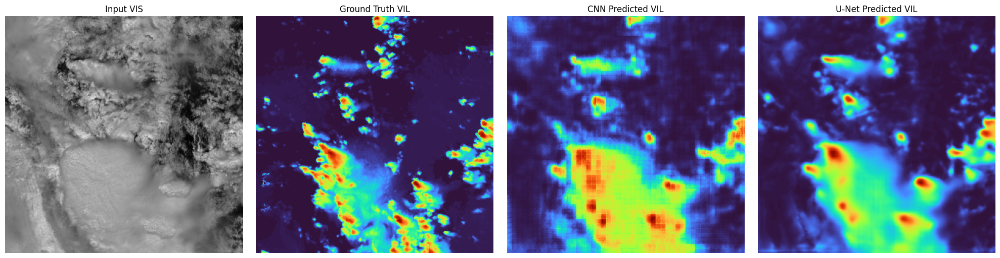

In [ ]:
# Load saved model paths
unet_saved_model_path = "/content/drive/MyDrive/unet_model.pth"
cnn_saved_model_path = "/content/drive/MyDrive/cnn_model.pth"

# Initialise the model
cnn_model = EnhancedCNNModel().to(device)
unet_model = UNet().to(device)

# Load model weights
cnn_model.load_state_dict(torch.load(cnn_saved_model_path))
unet_model.load_state_dict(torch.load(unet_saved_model_path))

# Set the model in evaluation mode
cnn_model.eval()
unet_model.eval()

# Randomly select a test sample index
sample_idx = np.random.randint(len(X_test))
input_sample = X_test_t[sample_idx].unsqueeze(0).to(device)
input_vis = X_test[sample_idx, :, :, 0]
ground_truth = Y_test_t[sample_idx].squeeze().cpu().numpy()

# Get predictions from both models
with torch.no_grad():
    cnn_prediction = cnn_model(input_sample).squeeze().cpu().numpy()
    unet_prediction = unet_model(input_sample).squeeze().cpu().numpy()

# Visual comparisons
fig, axes = plt.subplots(1, 4, figsize=(20, 5))


axes[0].imshow(input_vis, cmap="gray")
axes[0].set_title("Input VIS")
axes[0].axis("off")


axes[1].imshow(ground_truth, cmap="turbo")
axes[1].set_title("Ground Truth VIL")
axes[1].axis("off")


axes[2].imshow(cnn_prediction, cmap="turbo")
axes[2].set_title("CNN Predicted VIL")
axes[2].axis("off")


axes[3].imshow(unet_prediction, cmap="turbo")
axes[3].set_title("U-Net Predicted VIL")
axes[3].axis("off")

plt.tight_layout()
plt.show()




### **Analysis:**

**------ CNN prediction result:**

 the capture of high-intensity regions is weak, as the graph shows that the boundary of the red region is fuzzy and the distribution of the low intensity region (blue) is more diffuse, suggesting a certain amount of error.

**Model analysis:**

 The simple structure of the CNN may not be able to capture complex patterns in the input data, resulting in insufficient extraction of local features and edge information.

**------ U-Net prediction result:**

 The high intensity region (red) is clearer, the boundary is sharp and close to Ground Truth.
 The distribution of the low intensity region is also closer to the real data.

**Model analysis:**

 U-Net's skip connections allow features to propagate between different resolutions, thus retaining more detail and boundary information.

**------ Summary:**

 U-Net's strengths are particularly evident in its ability to better capture complex spatial patterns, with more accurate predictions for high-intensity regions and more complete details for low-intensity regions. On the other hand, the performance of CNN is more limited, due to the simple model structure, CNN's ability to capture details is limited, resulting in blurred boundaries and larger prediction bias.

# **2. Explainability**

### **i. Prediction Error Maps for CNN vs. U-Net**

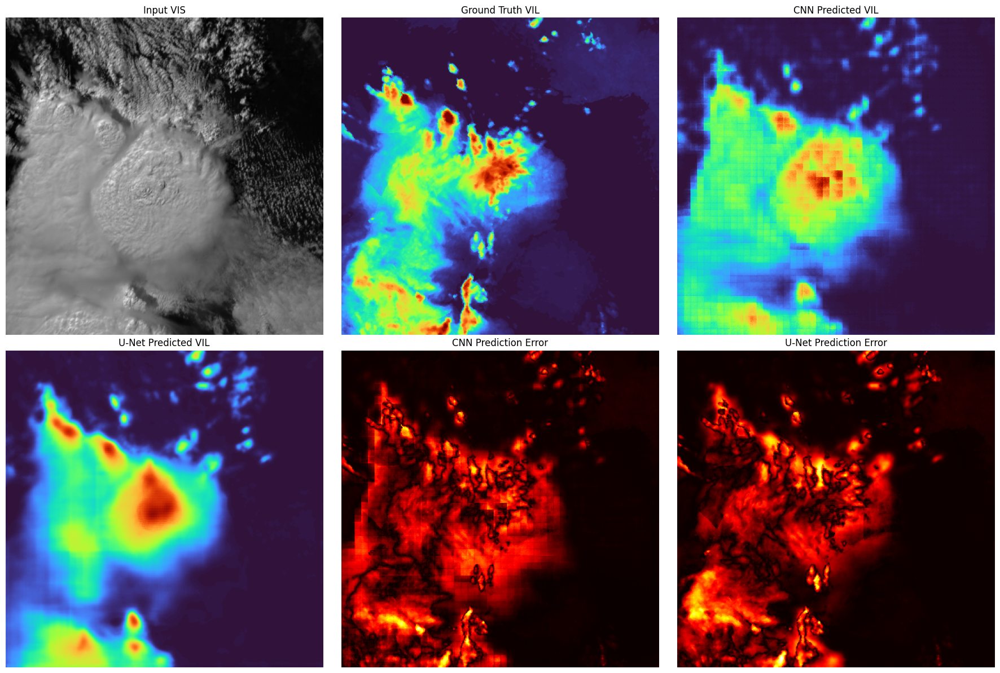

In [ ]:
# Select a sample
sample_idx = np.random.randint(len(X_test))
input_sample = X_test_t[sample_idx].unsqueeze(0).to(device)

# Predictions
with torch.no_grad():
    cnn_prediction = cnn_model(input_sample).squeeze().cpu().numpy()
    unet_prediction = unet_model(input_sample).squeeze().cpu().numpy()

ground_truth = Y_test[sample_idx].squeeze()

# Calculation error
cnn_error = np.abs(cnn_prediction - ground_truth)
unet_error = np.abs(unet_prediction - ground_truth)

# Plotting the results of analyses
fig, axes = plt.subplots(2, 3, figsize=(18, 12))


axes[0, 0].imshow(X_test[sample_idx, :, :, 0], cmap="gray")
axes[0, 0].set_title("Input VIS")
axes[0, 0].axis("off")

axes[0, 1].imshow(ground_truth, cmap="turbo")
axes[0, 1].set_title("Ground Truth VIL")
axes[0, 1].axis("off")

axes[0, 2].imshow(cnn_prediction, cmap="turbo")
axes[0, 2].set_title("CNN Predicted VIL")
axes[0, 2].axis("off")

axes[1, 0].imshow(unet_prediction, cmap="turbo")
axes[1, 0].set_title("U-Net Predicted VIL")
axes[1, 0].axis("off")

axes[1, 1].imshow(cnn_error, cmap="hot")
axes[1, 1].set_title("CNN Prediction Error")
axes[1, 1].axis("off")

axes[1, 2].imshow(unet_error, cmap="hot")
axes[1, 2].set_title("U-Net Prediction Error")
axes[1, 2].axis("off")

plt.tight_layout()
plt.show()





### **Comparative Analysis of Error Maps:**

**------CNN Prediction Error:**

 The error maps of CNN show more scattered and high-intensity error regions, especially in the high-intensity VIL region where the error is more significant. This indicates that the CNN model has limitations in capturing complex distribution patterns and details.

**Reason:**

The downsampling and upsampling process of the CNN model lacks jumping connections, which leads to the loss of some spatial details in the prediction process. As a result, the model performs poorly in predicting regions with complex boundaries and gradient changes.

**------U-Net Prediction Error:**

 The error map of U-Net shows a relatively uniform error distribution with low overall error values. Especially in high intensity regions, U-Net's error is significantly lower than CNN's, suggesting that its prediction is closer to the Ground Truth.

**Reason:**

 U-Net retains high-resolution feature information through skip connections, which allows the model to recover the spatial details of the inputs in the up-sampling phase. Its architectural design makes it more suitable for capturing complex regions and boundary details.

**------ Summary:**

 U-Net significantly outperforms CNN in capturing high-resolution spatial details and reducing errors. CNN tends to generate smooth predictions and tends to ignore details in critical regions.

### **ii. Saliency Maps for CNN vs. U-Net**



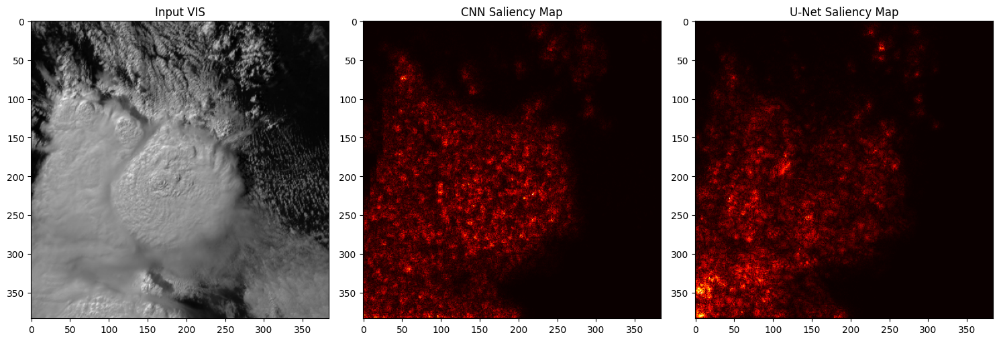

In [ ]:
# Aggregate channels when calculating Saliency Map
def compute_saliency_map(model, input_sample):
    input_sample.requires_grad = True
    output = model(input_sample)
    loss = output.sum()
    saliency, = grad(loss, input_sample)
    saliency = saliency.abs().max(dim=1)[0].squeeze().cpu().numpy()
    return saliency

# Calculate Saliency Map for CNN and U-Net
saliency_cnn = compute_saliency_map(cnn_model, input_sample)
saliency_unet = compute_saliency_map(unet_model, input_sample)


fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(X_test[sample_idx, :, :, 0], cmap="gray")
axes[0].set_title("Input VIS")

axes[1].imshow(saliency_cnn, cmap="hot")
axes[1].set_title("CNN Saliency Map")

axes[2].imshow(saliency_unet, cmap="hot")
axes[2].set_title("U-Net Saliency Map")

plt.tight_layout()
plt.show()




### **Comparative Analysis of Saliency Map of CNN and U-Net:**

**------CNN Saliency Map:**

 The second figure shows the Saliency Map of CNN, the highlighted parts indicate which regions of the input image the CNN is more sensitive to. From the figure, it can be observed that the activation regions are more sparsely distributed, responding in most regions of the image, but with lower response strength. The lower density of highlighted regions suggests that the feature extraction ability of the CNN may be weak and it is difficult to focus attention on key regions. This characteristic leads to a lack of accuracy in predicting complex structures.

**------U-Net Saliency Map:**

 The activation regions in the saliency map are more continuous and detailed, indicating that the U-Net model is able to focus more comprehensively on the global features of the input image. The activation intensity is more significant in key areas (e.g., high-intensity clouds).

**Advantage:**

 Skip connections allow U-Net to capture both local and global features in a more balanced way, which improves the spatial sensitivity and prediction accuracy of the model.

**------Summary:**

CNN focuses on the extraction of input features locally and lacks global information modelling of complex scenes.

U-Net not only retains the local information, but also integrates the global features more effectively through its jump connection mechanism.